See previous notebooks for info about the farmers protests.  In this notebook I'm looking at the frequency of different words/hashtags throughout the timeline of the dataset

In [58]:
import re
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
import string
import nltk
import warnings 
from wordcloud import WordCloud
from textblob import TextBlob
import plotly.express as px
import plotly.graph_objects as go



warnings.filterwarnings("ignore", category=DeprecationWarning)
%matplotlib inline


In [59]:
combi = pd.read_csv('jan26feb4final.csv', index_col = False)
combi = combi.drop(columns=['Unnamed: 0'])
combi.head()


,date,tweet,location
0,2021-01-28 23:59:59,"b""@saahilmenghani @sakshijoshii Me too awake. ...",NaN
1,2021-01-28 23:59:57,b'RT @dhruv_rathee: Godi Media + IT Cell + Gov...,NaN
2,2021-01-28 23:59:54,b'RT @GordyPls: Armed insurrection at the US c...,NaN
3,2021-01-28 23:59:54,b'@zephtx @grasshoppr93 Isn\xe2\x80\x99t that ...,NaN
4,2021-01-28 23:59:49,"b'When Reds opening day comes, Kyle Farmer wil...",NaN


In [60]:
#PREPROCESSING

def remove_pattern(input_txt, pattern):
    r = re.findall(pattern, input_txt)
    for i in r:
        input_txt = re.sub(i, '', input_txt)
        
    return input_txt    

# remove twitter handles (@user)
combi['tidy_tweet'] = np.vectorize(remove_pattern)(combi['tweet'], "@[\w]*")
combi['tidy_tweet'] = combi['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
combi['tidy_tweet'] = combi['tidy_tweet'].str.replace("Red Fort", "redfort")

#combi['tidy_tweet'] = combi['tidy_tweet'].str.replace("[#]", " ")
combi['tidy_tweet'] = combi['tidy_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))
tokenized_tweet = combi['tidy_tweet'].apply(lambda x: x.split())


#at this point your would stem but i haven't on my dataset yet
from nltk.stem.porter import *
stemmer = PorterStemmer()

tokenized_tweet = tokenized_tweet.apply(lambda x: [stemmer.stem(i) for i in x]) # stemming
tokenized_tweet.head()

for i in range(len(tokenized_tweet)):
    tokenized_tweet[i] = ' '.join(tokenized_tweet[i])

combi['tidy_tweet'] = tokenized_tweet

#ADDING DATETIMES
combi['date'] = pd.to_datetime(combi['date'])

combi['Month'] = combi['date'].apply(lambda time: time.month)
#combi['Day of Week'] = combi['date'].apply(lambda time: time.dayofweek)
combi['day of the month'] = combi['date'].dt.day
combi['Hour'] = combi['date'].apply(lambda time: time.hour)


#dmap = {0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'}

#combi['Day of Week'] = combi['Day of Week'].map(dmap)

#ADDING TWEET LENGTH
combi['length'] = combi['tweet'].apply(len)

#I will have to take the hashtags and examine them, then associate them with pos or neg in textblob

#haikyuu is a anime farmer and is not relevant to our dataset

searchfor = ['haikyuu']
combi = combi[~combi.tweet.str.contains('|'.join(searchfor))]

combi1 = combi.drop_duplicates()

checking for common words through wordcloud to explore their timeline distrbutions


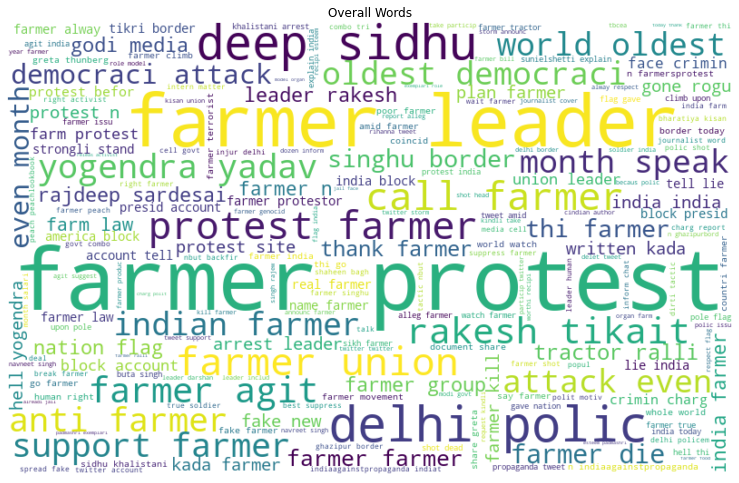

In [63]:
all_words = ' '.join([text for text in combi1['tidy_tweet']])


wordcloud = WordCloud(width=800, height=500, random_state=21, max_font_size=110, background_color="white").generate(all_words)
plt.figure(figsize=(13, 9))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')
plt.title('Overall Words')
plt.show()

Some sample code for if you want to check the proportion of a work in data

In [64]:
def check_word_in_tweet(word, data):
    """Checks if a word is in a Twitter dataset's text. 
    Checks text and extended tweet (140+ character tweets) for tweets,
    retweets and quoted tweets.
    Returns a logical pandas Series.
    """
    contains_column = data['tweet'].str.contains(word, case = False)
    return contains_column

In [65]:
modi = check_word_in_tweet('modi', combi1)
print("Proportion of tweets mentioning modi:", np.sum(modi) / combi1.shape[0])

Proportion of tweets mentioning modi: 0.055154979521080005


So, some interesting things happened throughout the timeline, and I'd like to visualize them here.  First off, rihanna had tweeted in support of the farmers. From the visualization below, we can see exactly when

In [66]:
def rihanna_present(tweet):
    if 'rihanna' in tweet.lower():
        return True
    else:
        return False
    
combi1['riri'] = combi1['tweet'].apply(lambda x: rihanna_present(x))
combirhi = combi1[combi1['riri'] == True]

<ipython-input-66-1bb258804536>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [68]:
fig2 = px.histogram(combirhi, x="date", y="riri", histfunc="count", title="Rihanna mentions overtime")
fig2.show()

The farmers have been labeled as terrorists or associated with the khalistani movement by the indian government and media in order to undermine their movement. Here we'll look at the khalistan/terrorist sentiments are highest

In [77]:
def khalistan_present(tweet):
    if 'khalistan' in tweet.lower() or 'khalistani' in tweet.lower():
        return True
    else:
        return False
    
combi1['khalistan'] = combi1['tweet'].apply(lambda x: khalistan_present(x))
combik = combi1[combi1['khalistan'] == True]

<ipython-input-77-e3c4db17f861>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [78]:
fig3 = px.histogram(combik, x="date", y="khalistan", histfunc="count", title="khalistan mentions overtime")
fig3.show()

In [79]:
def terror_present(tweet):
    if 'terrorist' in tweet.lower():
        return True 
    else:
        return False
    
combi1['terrorist'] = combi1['tweet'].apply(lambda x: terror_present(x))
combit = combi1[combi1['terrorist'] == True]

fig5 = px.histogram(combit, x="date", y="terrorist", histfunc="count", title="terrorist mentions")
fig5.show()

<ipython-input-79-42bff6904747>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [73]:
def rakesh_present(tweet):
    if 'rakesh' in tweet.lower() or 'tikait' in tweet.lower():
        return True 
    else:
        return False
    
combi1['r'] = combi1['tweet'].apply(lambda x: rakesh_present(x))
combir = combi1[combi1['r'] == True]

fig4 = px.histogram(combir, x="date", y="r", histfunc="count", title="rakesh tikait mentions")
fig4.show()

<ipython-input-73-dedd93ef4b68>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [54]:
def deep_present(tweet):
    if 'deep sidhu' in tweet.lower():
        return True 
    else:
        return False
    
combi1['ds'] = combi1['tweet'].apply(lambda x: deep_present(x))
combit = combi1[combi1['ds'] == True]

fig6 = px.histogram(combit, x="date", y="ds", histfunc="count", title="Histogram on Date Axes")
fig6.show()

<ipython-input-54-add238c9ff73>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [80]:
def police_present(tweet):
    if 'police' in tweet.lower():
        return True 
    else:
        return False
    
combi1['pol'] = combi1['tweet'].apply(lambda x: police_present(x))
combipol = combi1[combi1['pol'] == True]

fig7 = px.histogram(combipol, x="date", y="pol", histfunc="count", title="dehli police mentions")
fig7.show()

<ipython-input-80-945cda688ac6>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [81]:
# will try to compile these into the same plotly histogram